In [2]:
"""
downloading SDSS image for all the potential candidates and check each one individually to see whether they have 
the SDSS data

set up: SDSS that we use is DR12 with the image size of 400x400 pixel 
"""

'\ndownloading SDSS image for all the potential candidates and check each one individually to see whether they have \nthe SDSS data\n\nset up: SDSS that we use is DR12 with the image size of 400x400 pixel \n'

In [1]:
import os
import urllib2
import pandas as pd

import pylab as pl
import matplotlib.pyplot as plt
from matplotlib import image
%matplotlib inline

In [20]:
#scale 0.2 arcsec/pixel
def _fetch(outfile, RA, DEC, scale=0.2, width=1000, height=1000):
    """Fetch the image at the given RA, DEC from the SDSS server"""
    url = ("http://skyservice.pha.jhu.edu/DR12/ImgCutout/"
           "getjpeg.aspx?ra=%.8f&dec=%.8f&scale=%.2f&width=%i&height=%i"#&opt=OG" 
           % (RA, DEC, scale, width, height))
    print "downloading %s" % url
    print " -> %s" % outfile
    fhandle = urllib2.urlopen(url)
    open(outfile, 'w').write(fhandle.read())

def fetch_image(object_type):
    """Return the data array for the image of object type"""
    if not os.path.exists('downloads'):
        os.makedirs('downloads')

    filename = os.path.join('downloads', '%s_image.jpg' % object_type)
    if not os.path.exists(filename):
        RA = image_locations[object_type]['RA']
        DEC = image_locations[object_type]['DEC']
        _fetch(filename, RA, DEC)
        
    return image.imread(filename)

def fetch_image2(ra, dec, ind, name, xray=True):
    """Return the data array for the image of object type"""
    if not os.path.exists('downloads'):
        os.makedirs('downloads')
    if dec > 0:
        filename = os.path.join('downloads', '%s_%.8f+%.8f.jpg' % (name, ra, dec))
    if dec < 0:
        filename = os.path.join('downloads', '%s_%.8f%.8f.jpg' % (name, ra, dec))
    print filename
    if not os.path.exists(filename):
        _fetch(filename, ra, dec)
        #optional for putting xray position
        if xray:
            xray_pos(ra, dec, ind, filename)
    
def fetch_image3(ra, dec, ind, name, xray=True):
    """Return the data array for the image of object type"""
    if not os.path.exists('downloads'):
        os.makedirs('downloads')
    filename = os.path.join('downloads', '%s.jpg'%name)
    print filename
    if not os.path.exists(filename):
        _fetch(filename, ra, dec)
        #optional for putting xray position
        if xray:
            xray_pos(ra, dec, ind, filename)
    

def xray_pos(ra, dec, ind, filename):
    target=dff_sdss.loc[ind]
    d_ra=(target.ra-target.ra_m)*3600/0.2
    d_dec=(target.dec-target.dec_m)*3600/0.2

    I=image.imread(filename)
    fig,ax=plt.subplots(1)
    ax.imshow(I)
    ax.plot([400-d_ra],[400+d_dec],'x',color='red')
    ax.axis([0,800,0,800])
    ax.axes.get_xaxis().set_visible(False)
    ax.axes.get_yaxis().set_visible(False)

    fig.savefig('downloads/nimg%03i_%.8f+%.8f.png' % (ind, ra, dec) , bbox_inches = 'tight', pad_inches=0, dpi=200)

In [3]:
x=urllib2.urlopen("http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=101.25618917&dec=60.41442889&scale=0.20&width=400&height=400&opt=OG")
p=x.read()
y=urllib2.urlopen("http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=54.20787833&dec=-5.10290444&scale=0.20&width=400&height=400&opt=OG")
q=y.read()
z=urllib2.urlopen("http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=146.89771000&dec=58.51391889&scale=0.20&width=400&height=400&opt=OG")
r=z.read()
a=urllib2.urlopen("http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=33.37785583&dec=50.67009556&scale=0.20&width=400&height=400&opt=OG")
s=a.read()

In [4]:
print r==s
print p==q
print s==p

False
True
True


In [5]:
print y.info()

Cache-Control: private
Content-Type: image/jpeg
Server: Microsoft-IIS/8.5
Set-Cookie: ASP.NET_SessionId=0nk0jv0erv31sns0dwbncd10; path=/; HttpOnly
X-AspNet-Version: 4.0.30319
Access-Control-Allow-Origin: *
X-Powered-By: ASP.NET
Date: Wed, 11 Jan 2017 23:04:25 GMT
Connection: close
Content-Length: 9119



In [7]:
z.read()

''

<hr>

In [9]:
# read in all candidate to check whether they are data in SDSS
cut = pd.read_csv('/Users/taweewat/Documents/xray_project/result/cut-01.csv',\
                    keep_default_na=False, na_values=[""])

In [21]:
# read only select SDSS samples for red sequencing 
dff=pd.read_csv('/Users/taweewat/Documents/xray_project/ned-result/final_cut5.csv')
dff.followup.value_counts()

follow           303
followed         247
inSD/outside     124
outSD/outside     78
Name: followup, dtype: int64

In [22]:
dff_sdss=dff[dff.followup=='followed']
dff_sdss.columns
name=["SDSS%03i"%x for x in dff_sdss.index]
dff_sdss.loc[:,'name']=name

In [ ]:
#dff_sdss.to_csv('/Users/taweewat/Documents/xray_project/result/final_sdss.csv', index=False)

220.383313 60.314465
downloads/SDSS011.jpg
downloading http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=220.38331300&dec=60.31446500&scale=0.20&width=1000&height=1000
 -> downloads/SDSS011.jpg
219.941039 58.465298
downloads/SDSS019.jpg
downloading http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=219.94103900&dec=58.46529800&scale=0.20&width=1000&height=1000
 -> downloads/SDSS019.jpg
228.826162 55.259972
downloads/SDSS021.jpg
downloading http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=228.82616200&dec=55.25997200&scale=0.20&width=1000&height=1000
 -> downloads/SDSS021.jpg
155.765771 50.686817
downloads/SDSS027.jpg
downloading http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=155.76577100&dec=50.68681700&scale=0.20&width=1000&height=1000
 -> downloads/SDSS027.jpg
155.184939 49.346085
downloads/SDSS028.jpg
downloading http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=155.18493900&dec=49.34608500&scale=0.20&width=1000&height=1000
 

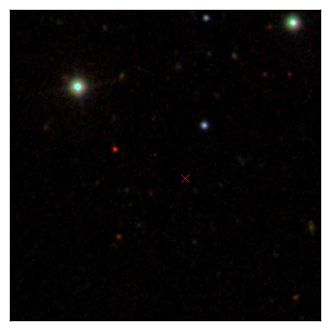

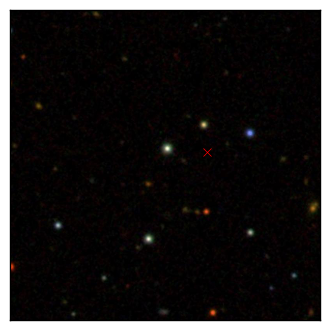

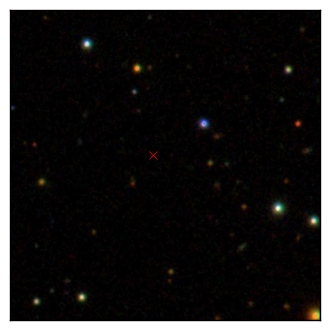

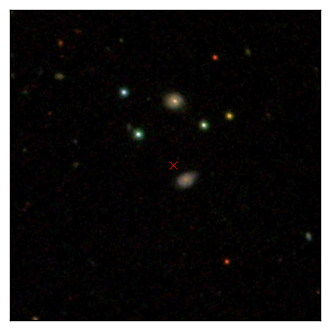

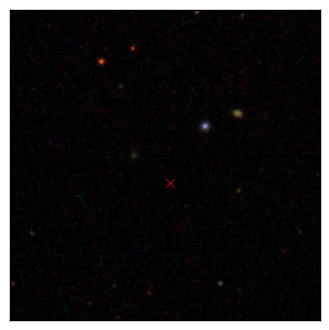

...

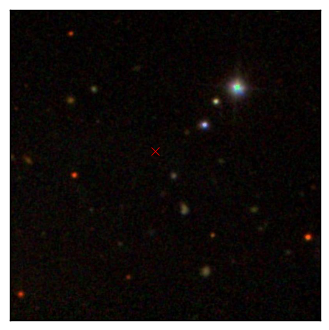

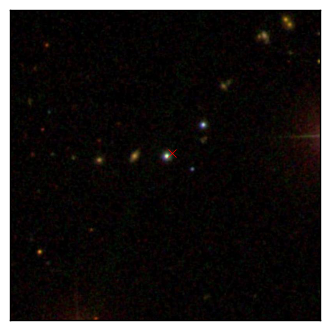

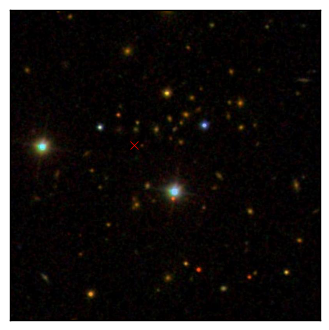

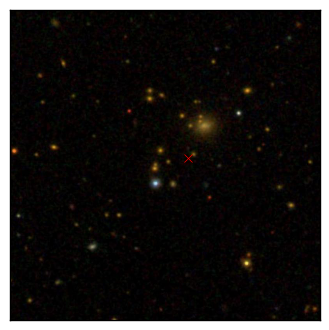

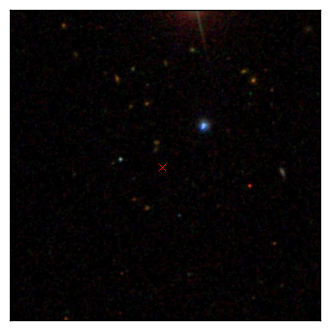

In [24]:
for index, row in dff_sdss.iterrows():
    print row['ra_m'], row['dec_m']
    ra=row['ra_m']
    dec=row['dec_m']
    name=row['name']
    fetch_image3(ra, dec, index, name)

In [106]:
x0,y0=214.69776,30.46796
fetch_image2(x0, y0, 1, xray=False)

downloads/img001_214.69776000+30.46796000.jpg
downloading http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=214.69776000&dec=30.46796000&scale=0.20&width=800&height=800&opt=OG
 -> downloads/img001_214.69776000+30.46796000.jpg


In [89]:
print target.ra, target.ra_m

151.20667 151.202833


In [85]:
target=dff_sdss.loc[9]
d_ra=(target.ra-target.ra_m)*3600/0.2
d_dec=(target.dec-target.dec_m)*3600/0.2
print d_ra, d_dec

69.0660000001 147.618


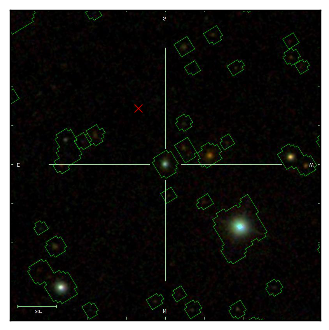

In [98]:
I=image.imread('downloads/img009_151.20283300+66.28401900.jpg')
fig,ax=plt.subplots(1)
ax.imshow(I)
ax.plot([400-d_ra],[400+d_dec],'x',color='red')
ax.axis([0,800,0,800])
ax.axes.get_xaxis().set_visible(False)
ax.axes.get_yaxis().set_visible(False)

fig.savefig('downloads/test.png', bbox_inches = 'tight', pad_inches=0, dpi=200)

<hr>

In [106]:
for index, row in cut.iterrows():
    print row['RA'], row['DEC']
    ra=row['RA']
    dec=row['DEC']
    fetch_image2(ra, dec, index)

133.04933 76.4540577778
downloads/img000_133.04933000+76.45405778.jpg
downloading http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=133.04933000&dec=76.45405778&scale=0.20&width=400&height=400&opt=OG
 -> downloads/img000_133.04933000+76.45405778.jpg
34.3791233333 73.8256644445
downloads/img001_34.37912333+73.82566444.jpg
downloading http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=34.37912333&dec=73.82566444&scale=0.20&width=400&height=400&opt=OG
 -> downloads/img001_34.37912333+73.82566444.jpg
137.121913334 72.2754022222
downloads/img002_137.12191333+72.27540222.jpg
downloading http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=137.12191333&dec=72.27540222&scale=0.20&width=400&height=400&opt=OG
 -> downloads/img002_137.12191333+72.27540222.jpg
156.653913334 70.5444716666
downloads/img003_156.65391333+70.54447167.jpg
downloading http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=156.65391333&dec=70.54447167&scale=0.20&width=400&height=400&opt=

downloading http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=180.63040108&dec=64.96767375&scale=0.20&width=400&height=400&opt=OG
 -> downloads/star_image.jpg
downloading http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=197.51943983&dec=0.94881436&scale=0.20&width=400&height=400&opt=OG
 -> downloads/galaxy_image.jpg
downloading http://skyservice.pha.jhu.edu/DR12/ImgCutout/getjpeg.aspx?ra=226.18451462&dec=4.07456639&scale=0.20&width=400&height=400&opt=OG
 -> downloads/quasar_image.jpg


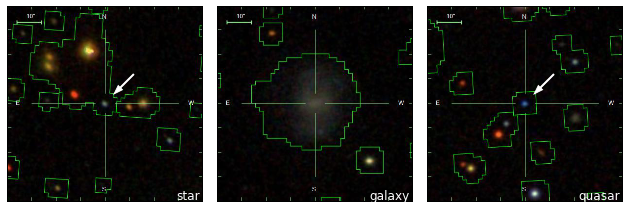

In [5]:
image_locations = dict(star=dict(RA=180.63040108,
                                 DEC=64.96767375),
                       galaxy=dict(RA=197.51943983,
                                   DEC=0.94881436),
                       quasar=dict(RA=226.18451462,
                                   DEC=4.07456639))

# Plot the images
fig = pl.figure(figsize=(9, 3))

# Check that PIL is installed for jpg support
if 'jpg' not in fig.canvas.get_supported_filetypes():
    raise ValueError("PIL required to load SDSS jpeg images")

object_types = ['star', 'galaxy', 'quasar']

for i, object_type in enumerate(object_types):
    ax = pl.subplot(131 + i, xticks=[], yticks=[])
    I = fetch_image(object_type)
    ax.imshow(I)
    if object_type != 'galaxy':
        pl.arrow(0.65, 0.65, -0.1, -0.1, width=0.005, head_width=0.03,
                 length_includes_head=True,
                 color='w', transform=ax.transAxes)
    pl.text(0.99, 0.01, object_type, fontsize='large', color='w', ha='right',
            transform=ax.transAxes)

pl.subplots_adjust(bottom=0.04, top=0.94, left=0.02, right=0.98, wspace=0.04)

In [99]:
print "%03i" % 83.00123123

083


In [97]:
cut.index

Int64Index([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,
            ...
            551, 552, 553, 554, 555, 556, 557, 558, 559, 560],
           dtype='int64', length=561)

In [2]:
import astropy